In [1]:
import anndata
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import scanpy as sc
import tifffile
from skimage.segmentation import find_boundaries
from skimage.transform import resize

In [2]:
%load_ext autoreload

In [3]:
%autoreload 2

In [4]:
import mip.utils as utils
from mip.gating import gate_region

Loading BokehJS ...

## load in data

In [5]:
# sample = 'HT323B1-H3'
# sample = 'HT339B1-H4A4'
# sample = 'HT397B1-H3A1'
sample = 'HT206B1-H1'
fp = f'/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/brca/{sample}/level_4/spatial_features.h5ad'

In [6]:
adata = sc.read_h5ad(fp)
adata

AnnData object with n_obs × n_vars = 143338 × 30
    obs: 'area', 'perimeter', 'bbox_row_min', 'bbox_col_min', 'bbox_row_max', 'bbox_col_max', 'centroid_row', 'centroid_col', 'eccentricity', 'DAPI intensity max', 'CD31 intensity max', 'E-cadherin intensity max', 'CD4 intensity max', 'CD20 intensity max', 'Ki67 intensity max', 'CD68 intensity max', 'Pan-CK intensity max', 'CD8 intensity max', 'Histone H3 Pho intensity max', 'CD163 intensity max', 'Podoplanin intensity max', 'CD3 intensity max', 'CD36 intensity max', 'HIF1a intensity max', 'GLUT1 intensity max', 'GATA3 intensity max', 'CD45RO intensity max', 'CD45RA intensity max', 'SMA intensity max', 'CK19 intensity max', 'MGP intensity max', 'Vimentin intensity max', 'Maspin intensity max', 'Foxp3 intensity max', 'MMP9 intensity max', 'HLA-DR intensity max', 'CK14 intensity max', 'CD11c intensity max', 'CD44 intensity max', 'DAPI intensity min', 'CD31 intensity min', 'E-cadherin intensity min', 'CD4 intensity min', 'CD20 intensity min

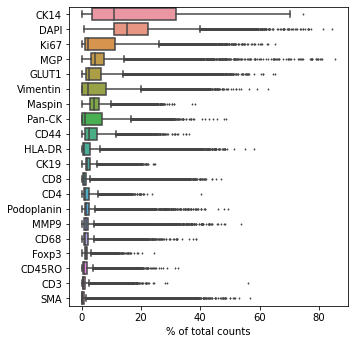

In [7]:
sc.pl.highest_expr_genes(adata, n_top=20, )

In [8]:
sc.pp.log1p(adata)

In [9]:
adata.var.index.to_list()

['DAPI',
 'CD31',
 'E-cadherin',
 'CD4',
 'CD20',
 'Ki67',
 'CD68',
 'Pan-CK',
 'CD8',
 'Histone H3 Pho',
 'CD163',
 'Podoplanin',
 'CD3',
 'CD36',
 'HIF1a',
 'GLUT1',
 'GATA3',
 'CD45RO',
 'CD45RA',
 'SMA',
 'CK19',
 'MGP',
 'Vimentin',
 'Maspin',
 'Foxp3',
 'MMP9',
 'HLA-DR',
 'CK14',
 'CD11c',
 'CD44']

In [10]:
adata.raw = adata

In [11]:
annotation_marker_map = {
    'Endothelial': ['CD31'],
    'Epithelial': ['E-cadherin', 'Pan-CK'],
    'B cell': ['CD20'],
    'Macrophage': ['CD68', 'CD163'],
    'DC': ['CD11c'],
#     'T cell': ['CD3', 'CD4', 'CD8', 'CD45RO', 'Foxp3'],
    'T cell': ['CD3', 'CD4', 'CD8', 'Foxp3'],
    'Fibroblast/Myo': ['Podoplanin', 'SMA', 'Vimentin'],
}
annotation_markers = [v for k, vs in annotation_marker_map.items() for v in vs]

In [12]:
# I've found it helpful to limit to markers only used in annotation
# This helps keep the clusters cleaner
adata = adata[:, annotation_markers]
adata

View of AnnData object with n_obs × n_vars = 143338 × 14
    obs: 'area', 'perimeter', 'bbox_row_min', 'bbox_col_min', 'bbox_row_max', 'bbox_col_max', 'centroid_row', 'centroid_col', 'eccentricity', 'DAPI intensity max', 'CD31 intensity max', 'E-cadherin intensity max', 'CD4 intensity max', 'CD20 intensity max', 'Ki67 intensity max', 'CD68 intensity max', 'Pan-CK intensity max', 'CD8 intensity max', 'Histone H3 Pho intensity max', 'CD163 intensity max', 'Podoplanin intensity max', 'CD3 intensity max', 'CD36 intensity max', 'HIF1a intensity max', 'GLUT1 intensity max', 'GATA3 intensity max', 'CD45RO intensity max', 'CD45RA intensity max', 'SMA intensity max', 'CK19 intensity max', 'MGP intensity max', 'Vimentin intensity max', 'Maspin intensity max', 'Foxp3 intensity max', 'MMP9 intensity max', 'HLA-DR intensity max', 'CK14 intensity max', 'CD11c intensity max', 'CD44 intensity max', 'DAPI intensity min', 'CD31 intensity min', 'E-cadherin intensity min', 'CD4 intensity min', 'CD20 inten

In [13]:
sc.pp.neighbors(adata, n_neighbors=15)

In [14]:
sc.tl.umap(adata)

In [15]:
sc.tl.leiden(adata, resolution=2.)

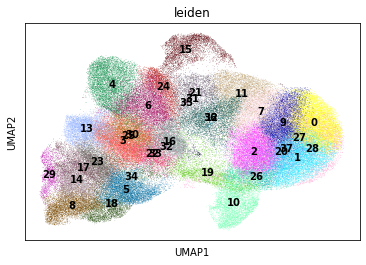

In [16]:
sc.pl.umap(adata, color=['leiden'], legend_loc='on data')

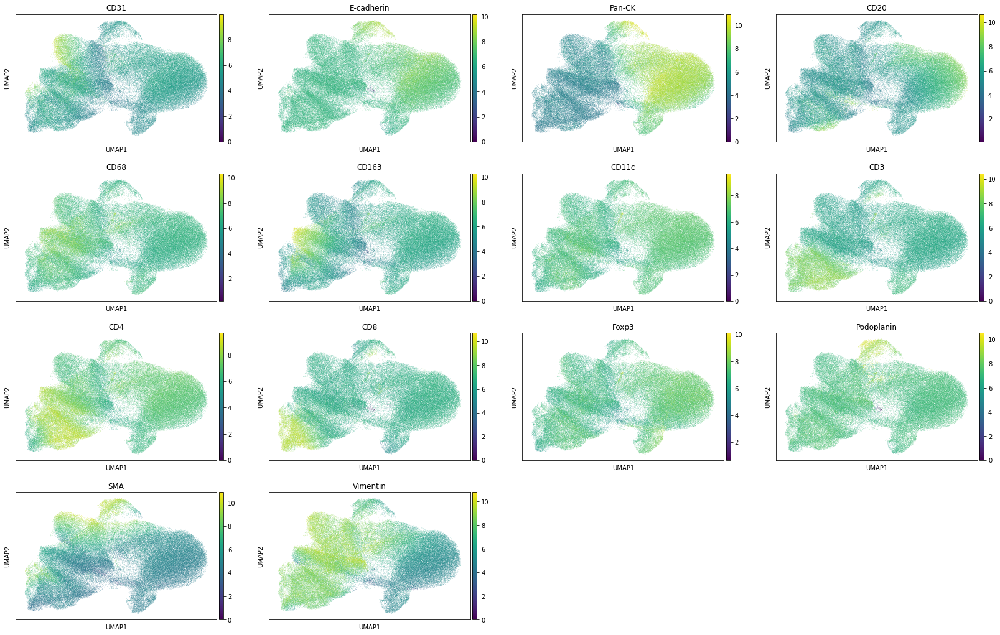

In [17]:
sc.pl.umap(adata, color=annotation_markers)

In [18]:
# cluster_map = {
#     'Immune': [9, 3, 18, 13, 17, 1, 8],
#     'Stroma': [7, 6, 20, 10],
#     'Epithelial': [15, 21, 11, 4, 12, 5, 19, 0, 2, 16, 14]
# }

# r = {str(v):k for k, vs in cluster_map.items() for v in vs}
# adata.obs['cell_type_general'] = [r.get(l, l)
#                           for l in adata.obs['leiden']]

In [19]:
# sc.pl.umap(adata, color=['cell_type_general'], ncols=1)

In [20]:
# adata.obs['centroid_row_inverted'] = [-x for x in adata.obs['centroid_row']]
# sc.pl.scatter(adata, x='centroid_col', y='centroid_row_inverted', color='cell_type_general')

In [21]:
# adata.write_h5ad(f'/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/brca/{sample}/level_4/cell_annotation_macro.h5ad')

In [81]:
cluster_map = {
    'Endothelial': [7],
    'Epithelial': [15, 21, 11, 4, 12, 5, 19, 0, 2, 16, 14],
    'CD8 T cell': [1],
    'CD4 T cell': [8, 13, 17],
    'Macrophage': [9, 3, 18],
    'Stroma': [6, 20, 10],
}

r = {str(v):k for k, vs in cluster_map.items() for v in vs}
adata.obs['cell_type_general'] = [r.get(l, l)
                          for l in adata.obs['leiden']]

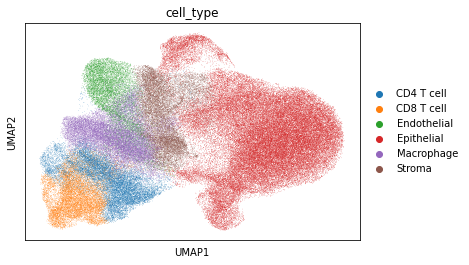

In [82]:
sc.pl.umap(adata, color=['cell_type'], ncols=1)

In [ ]:
adata.obs['centroid_row_inverted'] = [-x for x in adata.obs['centroid_row']]
sc.pl.scatter(adata, x='centroid_col', y='centroid_row_inverted', color='cell_type_general')

#### gating

In [22]:
adata = sc.read_h5ad(f'/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/brca/{sample}/level_4/cell_annotation_macro.h5ad')
adata

AnnData object with n_obs × n_vars = 143338 × 12
    obs: 'area', 'perimeter', 'bbox_row_min', 'bbox_col_min', 'bbox_row_max', 'bbox_col_max', 'centroid_row', 'centroid_col', 'eccentricity', 'DAPI intensity max', 'CD31 intensity max', 'E-cadherin intensity max', 'CD4 intensity max', 'CD20 intensity max', 'Ki67 intensity max', 'CD68 intensity max', 'Pan-CK intensity max', 'CD8 intensity max', 'Histone H3 Pho intensity max', 'CD163 intensity max', 'Podoplanin intensity max', 'CD3 intensity max', 'CD36 intensity max', 'HIF1a intensity max', 'GLUT1 intensity max', 'GATA3 intensity max', 'CD45RO intensity max', 'CD45RA intensity max', 'SMA intensity max', 'CK19 intensity max', 'MGP intensity max', 'Vimentin intensity max', 'Maspin intensity max', 'Foxp3 intensity max', 'MMP9 intensity max', 'HLA-DR intensity max', 'CK14 intensity max', 'CD11c intensity max', 'CD44 intensity max', 'DAPI intensity min', 'CD31 intensity min', 'E-cadherin intensity min', 'CD4 intensity min', 'CD20 intensity min

In [23]:
channel_to_img = utils.extract_ome_tiff(f'/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/brca/{sample}/level_2/{sample}.ome.tiff')
channel_to_img.keys()

dict_keys(['DAPI', 'CD31', 'E-cadherin', 'CD4', 'CD20', 'Ki67', 'CD68', 'Pan-CK', 'CD8', 'Histone H3 Pho', 'CD163', 'Podoplanin', 'CD3', 'CD36', 'HIF1a', 'GLUT1', 'GATA3', 'CD45RO', 'CD45RA', 'SMA', 'CK19', 'MGP', 'Vimentin', 'Maspin', 'Foxp3', 'MMP9', 'HLA-DR', 'CK14', 'CD11c', 'CD44'])

In [24]:
seg_img = tifffile.imread(f'/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/brca/{sample}/level_3/segmentation/cell_segmentation.tif')
boundary_img = find_boundaries(seg_img)
seg_img.shape

(15120, 13440)

In [25]:
pseudo = tifffile.imread(f'/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/brca/{sample}/level_2/pseudo.tiff')
pseudo.shape

(15120, 13440, 4)

In [26]:
# ## defaults
# gating_map = {
#     'Immune': {
#         'CD8_T_cell': {'CD8': 8.38, 'CD3e': 6.66},
#         'CD4_T_cell': {'CD4': 7.17, 'CD3e': 6.66},
#         'Macrophage': {'CD68': 7.53},
#         'B_cell': {'CD20': 7.69},
#         'DC': {('CD11c', 'HLA-DR'): 6.52},
#         'Fibroblast': {('Vimentin', 'Podoplanin', 'SMA'): 5.76}
#     },
#     'Stroma': {
#         'Endothelial': {'CD31': 7.35},
#         'Fibroblast': {('Vimentin', 'Podoplanin', 'SMA'): 5.76}
#     },
#     'Epithelial': {
#         'Epithelial': {('Pan-CK', 'E-cadherin'): 6.05},
#         'Myoepithelial': {('Podoplanin', 'SMA'): 7.88},
#         'Fibroblast': {('Vimentin', 'Podoplanin', 'SMA'): 5.76}
#     }
# }

In [62]:
# in case of different marker names
gating_map = {
    'Immune': {
        'CD8_T_cell': {'CD8': 8.38, 'CD3': 6.66},
        'CD4_T_cell': {'CD4': 7.17, 'CD3': 6.66},
        'Macrophage': {'CD68': 7.53},
        'B_cell': {'CD20': 7.69},
        'DC': {'CD11c': 6.52},
        'Fibroblast': {('Podoplanin', 'SMA'): 5.76}
    },
    'Stroma': {
        'Endothelial': {'CD31': 7.35},
        'Fibroblast': {('Podoplanin', 'SMA'): 5.76}
    },
    'Epithelial': {
        'Epithelial': {('Pan-CK', 'E-cadherin'): 6.05},
        'Myoepithelial': {('Podoplanin', 'SMA'): 7.88},
        'Fibroblast': {('Podoplanin', 'SMA'): 5.76}
    }
}

###### cd8 t cell

In [28]:
channel = 'CD8'
gate_region(adata, channel, channel_img=channel_to_img[channel], boundary_img=boundary_img,
            cell_type='Immune', cell_type_col='cell_type_general',
            default_value=gating_map['Immune']['CD8_T_cell'][channel], radius=500)

(958, 1958, 2573, 3573)

In [29]:
channel = 'CD8'
gate_region(adata, channel, channel_img=channel_to_img[channel], boundary_img=boundary_img,
            cell_type='15', cell_type_col='leiden',
            default_value=gating_map['Immune']['CD8_T_cell'][channel])

(11052, 11452, 1792, 2192)

In [30]:
channel = 'CD3'
gate_region(adata, channel, channel_img=channel_to_img[channel], boundary_img=boundary_img,
            cell_type='Immune', cell_type_col='cell_type_general',
            default_value=gating_map['Immune']['CD8_T_cell'][channel])

(4689, 5089, 12132, 12532)

In [63]:
gating_map['Immune']['CD8_T_cell'] = {
    'CD8': 8.34,
    'CD3': 6.66
}

###### cd4 t cell

In [32]:
channel = 'CD4'
gate_region(adata, channel, channel_img=channel_to_img[channel], boundary_img=boundary_img,
            cell_type='Immune', cell_type_col='cell_type_general',
            default_value=gating_map['Immune']['CD4_T_cell'][channel])

(4689, 5089, 12132, 12532)

In [ ]:
gate_region(adata, channel, channel_img=channel_to_img[channel], boundary_img=boundary_img,
            cell_type='11', cell_type_col='leiden',
            default_value=gating_map['Immune']['CD4_T_cell'][channel])

In [ ]:
channel = 'CD3e'
gate_region(adata, channel, channel_img=channel_to_img[channel], boundary_img=boundary_img,
            cell_type='Immune', cell_type_col='cell_type_general',
            default_value=gating_map['Immune']['CD4_T_cell'][channel])

In [64]:
gating_map['Immune']['CD4_T_cell'] = {
    'CD4': 7.68,
    'CD3': 6.66
}

###### macrophage

In [34]:
channel = 'CD68'
gate_region(adata, channel, channel_img=channel_to_img[channel], boundary_img=boundary_img,
            cell_type='Immune', cell_type_col='cell_type_general',
            default_value=gating_map['Immune']['Macrophage'][channel])

(4689, 5089, 12132, 12532)

In [36]:
gate_region(adata, channel, channel_img=channel_to_img[channel], boundary_img=boundary_img,
            cell_type='9', cell_type_col='leiden',
            default_value=gating_map['Immune']['Macrophage'][channel], radius=500)

Loading BokehJS ...

((8183, 9183, 11771, 12771),
 (0.5412037037037037,
  0.6073412698412698,
  0.8758184523809524,
  0.9502232142857143))

In [65]:
gating_map['Immune']['Macrophage'] = {
    'CD68': 7.35
}

###### B cell

In [38]:
channel = 'CD20'
r1, r2, c1, c2 = gate_region(
    adata, channel, channel_img=channel_to_img[channel], boundary_img=boundary_img,
    cell_type='Immune', cell_type_col='cell_type_general',
    default_value=gating_map['Immune']['B_cell'][channel]
)

ValueError: not enough values to unpack (expected 4, got 2)

In [ ]:
gate_region(adata, channel, channel_img=channel_to_img[channel], boundary_img=boundary_img,
            cell_type='13', cell_type_col='leiden',
            default_value=gating_map['Immune']['B_cell'][channel])

In [66]:
gating_map['Immune']['B_cell'] = {
    'CD20': 6.74
}

In [ ]:
# plt.imshow(pseudo[r1:r2, c1:c2])

###### DC

In [47]:
channel = 'CD11c'
r1, r2, c1, c2 = gate_region(
    adata, channel, channel_img=channel_to_img[channel], boundary_img=boundary_img,
    cell_type='Immune', cell_type_col='cell_type_general',
    default_value=gating_map['Immune']['DC'][channel]
)

ValueError: not enough values to unpack (expected 4, got 2)

In [48]:
# # channel = ('CD11c', 'HLA-DR')
# channel = 'CD11c'
# # img = channel_to_img['CD11c'] + channel_to_img['HLA-DR']
# img = channel_to_img['CD11c']
# r1, r2, c1, c2 = gate_region(
#     adata, channel, channel_img=img, boundary_img=boundary_img,
#     cell_type='Immune', cell_type_col='leiden',
#     default_value=gating_map['Immune']['DC'].get(channel, 0.)
# )

In [ ]:
gate_region(adata, channel, channel_img=img, boundary_img=boundary_img,
            cell_type='3', cell_type_col='leiden',
            default_value=gating_map['Immune']['DC'].get(channel, 0.))

In [67]:
gating_map['Immune']['DC'] = {
    'CD11c': 7.51
}

###### Endothelial

In [50]:
channel = 'CD31'
r1, r2, c1, c2 = gate_region(
    adata, channel, channel_img=channel_to_img[channel], boundary_img=boundary_img,
    cell_type='Stroma', cell_type_col='cell_type_general',
    default_value=gating_map['Stroma']['Endothelial'][channel]
)

ValueError: not enough values to unpack (expected 4, got 2)

In [ ]:
r1, r2, c1, c2 = gate_region(
    adata, channel, channel_img=channel_to_img[channel], boundary_img=boundary_img,
    cell_type='4', cell_type_col='leiden',
    default_value=gating_map['Stroma']['Endothelial'][channel], radius=500
)

In [68]:
gating_map['Stroma']['Endothelial'] = {
    'CD31': 6.91
}

###### Fibroblast

In [73]:
channel = ('Podoplanin', 'SMA')
img = (channel_to_img['Podoplanin'] + channel_to_img['SMA']) / 2
gate_region(
    adata, channel, channel_img=img, boundary_img=boundary_img,
    cell_type='Stroma', cell_type_col='cell_type_general',
    default_value=gating_map['Stroma']['Fibroblast'][channel]
)

((1931, 2331, 8487, 8887),
 (0.12771164021164022,
  0.15416666666666667,
  0.6314732142857142,
  0.661235119047619))

In [74]:
gate_region(
    adata, channel, channel_img=img, boundary_img=boundary_img,
    cell_type='15', cell_type_col='leiden',
    default_value=gating_map['Stroma']['Fibroblast'][channel]
)

((11052, 11452, 1792, 2192),
 (0.7309523809523809,
  0.7574074074074074,
  0.13333333333333333,
  0.1630952380952381))

In [ ]:
gating_map['Stroma']['Fibroblast'] = {
    ('Vimentin', 'Podoplanin', 'SMA'): 5.07
}
gating_map['Immune']['Fibroblast'] = {
    ('Vimentin', 'Podoplanin', 'SMA'): 5.07
}
gating_map['Epithelial']['Fibroblast'] = {
    ('Vimentin', 'Podoplanin', 'SMA'): 5.07
}

###### Epithelial

In [ ]:
channel = ('Pan-CK', 'E-cadherin')
img = channel_to_img['Pan-CK'] + channel_to_img['E-cadherin']
r1, r2, c1, c2 = gate_region(
    adata, channel, channel_img=img, boundary_img=boundary_img,
    cell_type='Epithelial', cell_type_col='cell_type_general',
    default_value=gating_map['Epithelial']['Epithelial'].get(channel, 0.)
)

In [ ]:
r1, r2, c1, c2 = gate_region(
    adata, channel, channel_img=img, boundary_img=boundary_img,
    cell_type='3', cell_type_col='leiden',
    default_value=gating_map['Epithelial']['Epithelial'][channel]
)

In [ ]:
gating_map['Epithelial']['Epithelial'] = {
    ('Pan-CK', 'E-cadherin'): 6.05
}

In [ ]:
# plt.imshow(pseudo[r1:r2, c1:c2])

###### Myoepithelial

In [ ]:
channel = ('Podoplanin', 'SMA')
img = channel_to_img['Podoplanin'] + channel_to_img['SMA']
r1, r2, c1, c2 = gate_region(
    adata, channel, channel_img=img, boundary_img=boundary_img,
    cell_type='Epithelial', cell_type_col='cell_type_general',
    default_value=gating_map['Epithelial']['Myoepithelial'][channel]
)

In [ ]:
r1, r2, c1, c2 = gate_region(
    adata, channel, channel_img=img, boundary_img=boundary_img,
    cell_type='2', cell_type_col='leiden',
    default_value=gating_map['Epithelial']['Myoepithelial'][channel],
    radius=500
)

In [ ]:
plt.imshow(pseudo[r1:r2, c1:c2])

In [ ]:
gating_map['Epithelial']['Myoepithelial'] = {
    ('Podoplanin', 'SMA'): 6.38
}

###### call cell types

In [ ]:
gating_map

In [ ]:
def bin_cells(adata, marker_dict, valid_mask=None):
    keep = []
    for k, v in marker_dict.items():
        keep.append([True if x >= v else False
                    for i, x in enumerate(adata.raw[:, k].X.mean(axis=1).flatten())])
    keep = np.asarray(keep)
    bools = keep.sum(axis=0) == len(marker_dict)
    
    if valid_mask is not None:
        bools = bools & valid_mask
    
    return bools

In [ ]:
cell_type = np.asarray(['Other'] * adata.shape[0], dtype=object)
order_of_operations = [
    'Fibroblast',
    'Endothelial',
    'CD4_T_cell',
    'CD8_T_cell',
    'Macrophage',
    'B_cell',
    'DC',
    'Epithelial',
    'Myoepithelial'
]
for general, d1 in gating_map.items():
    order = [ct for ct in order_of_operations if ct in d1.keys()]
    for ct in order:
        bools = bin_cells(adata, d1[ct], valid_mask=adata.obs['cell_type_general']==general)
        cell_type[bools] = ct
adata.obs['cell_type'] = list(cell_type)

In [ ]:
sc.pl.umap(adata, color=['cell_type'], ncols=1)

In [ ]:
sc.pl.umap(adata, color=['cell_type_general'], ncols=1)

In [ ]:
sc.pl.scatter(adata, x='centroid_col', y='centroid_row_inverted', color='cell_type')

#### other cell types

In [ ]:
adata.obs['cell_type_specific'] = adata.obs['cell_type'].to_list()

###### proliferating cells

In [ ]:
default_value = 8.73
# default_value = 7.84

In [ ]:
channel = 'Ki67'
r1, r2, c1, c2 = gate_region(
    adata, channel, channel_img=channel_to_img[channel], boundary_img=boundary_img,
    cell_type='Epithelial', cell_type_col='cell_type_general',
    default_value=default_value, radius=500
)

In [ ]:
channel = 'Ki67'
r1, r2, c1, c2 = gate_region(
    adata, channel, channel_img=channel_to_img[channel], boundary_img=boundary_img,
    cell_type='Immune', cell_type_col='cell_type_general',
    default_value=default_value
)

In [ ]:
r1, r2, c1, c2 = gate_region(
    adata, channel, channel_img=channel_to_img[channel], boundary_img=boundary_img,
    cell_type='0', cell_type_col='leiden',
    default_value=default_value
)

In [ ]:
adata.obs['is_proliferating'] = ['Yes' if m > default_value else 'False'
                                 for m in adata.raw[:, channel].X.flatten()]

In [ ]:
adata.obs['centroid_row_inverted'] = [-x for x in adata.obs['centroid_row']]
sc.pl.scatter(adata, x='centroid_col', y='centroid_row_inverted', color='is_proliferating')

In [ ]:
gating_map['is_proliferating'] = {'Ki67': default_value}

###### m1 vs m2 macrophage

In [ ]:
default_value = 7.17
# default_value = 5.81

In [ ]:
channel = 'CD163'
r1, r2, c1, c2 = gate_region(
    adata, channel, channel_img=channel_to_img[channel], boundary_img=boundary_img,
    cell_type='Macrophage', cell_type_col='cell_type',
    default_value=default_value, radius=500
)

In [ ]:
def call_cell(ct, x):
    if ct == 'Macrophage':
        if x >= default_value:
            return 'Macrophage - M1'
        else:
            return 'Macrophage - M2'
    return ct
    
adata.obs['cell_type_specific'] = [call_cell(ct, x)
                                   for ct, x in zip(adata.obs['cell_type'], adata.raw[:, channel].X.flatten())]

In [ ]:
sc.pl.scatter(adata, x='centroid_col', y='centroid_row_inverted', color='cell_type_specific')

In [ ]:
gating_map['M1_v2_M2_Macrophage'] = {'CD163': default_value}

#### add low-res spatial tifs

In [ ]:
scale_factor = .2
pseudo_small = resize(pseudo, (pseudo.shape[0] * scale_factor, pseudo.shape[1] * scale_factor),
                      anti_aliasing=False)
pseudo_small.shape

In [ ]:
adata.obsm['spatial'] = adata.obs[['centroid_col', 'centroid_row']].values
spatial_key = "spatial"
library_id = sample
adata.uns[spatial_key] = {library_id: {}}
adata.uns[spatial_key][library_id]["images"] = {"hires": pseudo_small}
adata.uns[spatial_key][library_id]["scalefactors"] = {
    "tissue_hires_scalef": scale_factor, "spot_diameter_fullres": 10}

for channel, img in channel_to_img.items():
    print(channel)
    adata.uns[spatial_key][library_id]["images"][channel] = resize(
        img, (img.shape[0] * scale_factor, img.shape[1] * scale_factor), anti_aliasing=True)
    adata.uns[spatial_key][library_id]["scalefactors"][f"tissue_{channel}_scalef"] = scale_factor


In [ ]:
sc.pl.spatial(adata, color='cell_type_specific', crop_coord=[5000, 6000, 5000, 6000])

#### save object

In [ ]:
# this looks horrible
ks = []
for k, d1 in gating_map.items():
    for k2, d2 in d1.items():
        if isinstance(d2, dict):
            for k3 in d2.keys():
                v = d2[k3]
                if isinstance(k3, tuple):
                    d2['_'.join(k3)] = v
                    ks.append(k3)
                    d2.pop(k3)         
    
adata.uns['gates'] = gating_map
adata.uns['cell_typing_order'] = order_of_operations

In [ ]:
adata.write_h5ad(f'/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/brca/{sample}/level_4/cell_annotation_full.h5ad')


In [9]:
adata.obs.to_csv(f'/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/brca/{sample}/level_4/cell_annotation_full.txt', sep='\t')

In [10]:
adata.obs

,area,perimeter,bbox_row_min,bbox_col_min,bbox_row_max,bbox_col_max,centroid_row,centroid_col,eccentricity,DAPI intensity max,...,CK14 intensity min,CD11c intensity min,CD44 intensity min,leiden,cell_type,centroid_row_inverted,cell_type_macro,cell_type_general,is_proliferating,cell_type_specific
CellID,,,,,,,,,,,,,,,,,,,,,
1,520,110.840620,0,3673,25,3709,8.378846,3693.750000,0.723583,49006.0,...,1547.0,404.0,38.0,0,Epithelial,-8.378846,Epithelial,Epithelial,Yes,Epithelial
2,409,98.704581,0,3711,26,3740,8.728606,3722.951100,0.452175,44971.0,...,4518.0,61.0,29.0,2,Epithelial,-8.728606,Epithelial,Epithelial,Yes,Epithelial
3,845,150.675144,0,3739,32,3776,13.584615,3755.928994,0.368285,49170.0,...,8671.0,21.0,71.0,2,Epithelial,-13.584615,Epithelial,Epithelial,Yes,Epithelial
4,241,70.870058,0,3873,12,3902,4.082988,3886.991701,0.928244,49978.0,...,56332.0,283.0,95.0,2,Epithelial,-4.082988,Epithelial,Epithelial,Yes,Epithelial
5,733,115.639610,0,3888,35,3921,16.049113,3906.064120,0.497079,59773.0,...,4903.0,65.0,66.0,2,Epithelial,-16.049113,Epithelial,Epithelial,Yes,Epithelial
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
221077,340,80.970563,15108,10235,15120,10268,15114.164706,10249.664706,0.935688,26368.0,...,1728.0,46.0,636.0,3,Fibroblast,-15114.164706,Other,Immune,False,Fibroblast
221078,162,62.248737,15107,9158,15120,9182,15115.290123,9168.080247,0.861327,44711.0,...,52670.0,445.0,910.0,1,Epithelial,-15115.290123,Epithelial,Epithelial,Yes,Epithelial
221079,35,24.485281,15116,9213,15120,9224,15117.828571,9218.000000,0.938642,33583.0,...,13957.0,810.0,507.0,1,Epithelial,-15117.828571,Epithelial,Epithelial,Yes,Epithelial


In [14]:
set(adata.obs['cell_type'])

{'B_cell',
 'CD4_T_cell',
 'CD8_T_cell',
 'DC',
 'Endothelial',
 'Epithelial',
 'Fibroblast',
 'Macrophage',
 'Myoepithelial',
 'Other'}

In [7]:
sample = 'HT206B1-H1'
adata = sc.read_h5ad(f'/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/brca/{sample}/level_4/cell_annotation_full.h5ad')


#### qitissue cluster file

In [77]:
df = adata.obs[['cell_type_general']]
df.index.name = 'CellID'
df.columns = ['Cluster']

m = {
    'Epithelial': '1',
    'Stroma': '2',
    'Immune': '3'
}

df['label'] = df['Cluster'].to_list()
df['Cluster'] = [m[x] for x in df['Cluster']]

df.to_csv(f'/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/brca/{sample}/level_4/cell_annotation_macro.csv')

/diskmnt/Projects/Users/estorrs/miniconda3/envs/squidpy/lib/python3.7/site-packages/ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # This is added back by InteractiveShellApp.init_path()
/diskmnt/Projects/Users/estorrs/miniconda3/envs/squidpy/lib/python3.7/site-packages/ipykernel_launcher.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if sys.path[0] == "":


In [ ]:
df = adata.obs[['cell_type']]
df.index.name = 'CellID'
df.columns = ['Cluster']

m = {
    'CD8 T cell': '1',
    'CD4 T cell': '2',
    'Endothelial': '3',
    'Epithelial': '4',
    'Macrophage': '5',
    'Stroma': '6',
}

df['label'] = df['Cluster'].to_list()
df['Cluster'] = [m[x] for x in df['Cluster']]

df.to_csv(f'/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/brca/{sample}/level_4/cell_annotation_macro.csv')

In [78]:
df

,Cluster,label
CellID,,
1,1,Epithelial
2,1,Epithelial
3,1,Epithelial
4,1,Epithelial
5,1,Epithelial
...,...,...
143334,3,Immune
143335,3,Immune
143336,1,Epithelial
